In [1]:
import xarray as xr
#import rioxarray as rxr
import xesmf as xe
import pandas as pd
import numpy as np
import calendar as cld
import matplotlib.pyplot as plt
import matplotlib.colors
colors_land = plt.cm.terrain(np.linspace(0.25, 1, 256))
import proplot as pplt # New plot library (https://proplot.readthedocs.io/en/latest/)
pplt.rc['savefig.dpi'] = 300 # 1200 is too big! #https://proplot.readthedocs.io/en/latest/basics.html#Creating-figures
from scipy.stats import chi2
from numba import njit,prange
import matplotlib as mpl
mpl.rcParams['hatch.linewidth'] = 0.05  # previous pdf hatch linewidth
from matplotlib.dates import DateFormatter

from pyproj import CRS,Transformer,Proj

import sys
sys.path.insert(1, '/home/castelli/Notebooks/PhD/utils') # to include my util file in previous directory
import utils as u
u.check_python_version()

3.10.13 | packaged by conda-forge | (main, Oct 26 2023, 18:07:37) [GCC 12.3.0]


In [2]:
def daily_to_monthly(var_array,leap_year): # var_array must be 365 or 366 days, in shape [time,x,y]
    list_monthly_var = []
    day = 0
    
    if leap_year:
        month_days = [31,29,31,30,31,30,31,31,30,31,30,31]
    else:
        month_days = [31,28,31,30,31,30,31,31,30,31,30,31]
    
    for i in range(12):
        eom = day + month_days[i] #eom : end of month
        result = var_array[day:eom].mean(axis=0)
        list_monthly_var.append(result)
        day = eom

    monthly_var = np.stack(list_monthly_var)
    return monthly_var

In [3]:
ds = xr.open_dataset('/bettik/beaumetj/MARout/MAR-EC-Earth3/MARgrid_EUe.nc')

imin = 32 ; imax = -30
jmin = 20 ; jmax = -15
lon = np.array(ds.LON[jmin:jmax,imin:imax])
lat = np.array(ds.LAT[jmin:jmax,imin:imax])
H = np.array(ds.SH[jmin:jmax,imin:imax])
nlat,nlon = 91, 139

normal_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':True,
                 'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}
big_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':True,
              'lonlines':2, 'latlines':2, 'abc':False, 'latlim':[42.,50],'lonlim':[3.,18.]}
multiplot_format = {'gridlinewidth':0.1, 'gridcolor':'gray8', 'gridalpha':0.5, 'coast':True,'borders':True ,'reso':'hi', 'labels':False, 'lonlines':2,
                    'latlines':2, 'abc':False, 'latlim':[43.,48.5],'lonlim':[4.,16.]}

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

In [4]:
ds

<xarray.Dataset>
Dimensions:  (sector: 3, y: 126, x: 201)
Coordinates:
  * sector   (sector) float32 1.0 2.0 3.0
  * x        (x) float32 -483.0 -476.0 -469.0 -462.0 ... 896.0 903.0 910.0 917.0
  * y        (y) float32 -308.0 -301.0 -294.0 -287.0 ... 546.0 553.0 560.0 567.0
Data variables:
    FRV      (sector, y, x) float32 ...
    LAT      (y, x) float32 ...
    LON      (y, x) float32 ...
    MSK      (y, x) float32 ...
    SH       (y, x) float32 ...
    SOL      (y, x) float32 ...
    SRF      (y, x) float32 ...
    VEG      (sector, y, x) float32 ...
Attributes:
    title:        ICE - Exp: y50 - 19811201
    institution:  ULg (Xavier Fettweis)
    history:      Fri Dec 17 11:42:05 2021: ncks -v LAT,LON,MSK,SH,SOL,SRF,VE...
    netcdf:       4.1.1 of Feb 12 2011 08:44:29 $
    NCO:          netCDF Operators version 4.9.1 (Homepage = http://nco.sf.ne...

In [5]:
# function for seasonal mean (from Ian)
def season_mean(ds, calendar="standard"):
    #make a DataArray with the season of each day
    seas_array = ds.time.dt.season
    
    # count days in winter season (varies with leap years)
    nb_DJF = seas_array.str.count('DJF').sum()
    
    wgt_DJF = 1/nb_DJF.values.item()
    wgt_MAM = 1/(31+30+31)
    wgt_JJA = 1/(30+31+31)
    wgt_SON = 1/(30+31+30)

    weight = seas_array.str.replace('DJF',str(wgt_DJF)).str.replace('MAM',str(wgt_MAM)).str.replace('JJA',str(wgt_JJA)).str.replace('SON',str(wgt_SON))
    weight = weight.astype('float')
    
    # Test that the sum of the weights for each season is 1.0
    np.testing.assert_allclose(weight.groupby("time.season").sum().values, np.ones(4))

    # Calculate the weighted average
    return (ds * weight).groupby("time.season").sum(dim="time")

In [6]:
def detect_alps(H):
    nlat,nlon = np.shape(H)
    mask = np.bool_(np.zeros((nlat,nlon)))
    r = 4
    for j in range(r,nlat-r):
        for i in range(r,nlon-r):
            mask[j,i] = np.logical_and(H[j,i]>360 ,np.any(H[j-r:j+r,i-r:i+r]>1300))
            # mask[j,i] = np.std(H[j-r:j+r,i-r:i+r])>200
    return mask
alps = detect_alps(H)
alps[lon<4.8] = False
alps[np.logical_and(lon>10,lat<45.2)] = False

In [7]:
path_ju = '/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.'
path_ian = '/bettik/castelli/data/MAR3.14/MAR-ERA5/EUb/ICE.ERA5.EUb.'
#path_ian = '/bettik/castelli/data/MAR3.14/MAR-ERA5/EUc/ICE.ERA5.EUc.'

In [8]:
ds_T_normal = xr.open_dataset(path_ju+'TTz.2014.nc')
ds_T_normal

<xarray.Dataset>
Dimensions:  (time: 365, ztqlev: 4, y: 126, x: 201)
Coordinates:
  * time     (time) datetime64[ns] 2014-01-01T12:00:00 ... 2014-12-31T12:00:00
  * x        (x) float32 -483.0 -476.0 -469.0 -462.0 ... 896.0 903.0 910.0 917.0
  * y        (y) float32 -308.0 -301.0 -294.0 -287.0 ... 546.0 553.0 560.0 567.0
  * ztqlev   (ztqlev) float32 2.0 10.0 50.0 100.0
Data variables:
    TTz      (time, ztqlev, y, x) float32 ...
Attributes:
    title:        ICE - Exp: l12 - 20140101
    institution:  ULg (Xavier Fettweis)
    history:      Thu May 14 23:59:20 2020: ncks -v TTz ICE.l12.2014.01.01-31...
    netcdf:       4.1.1 of Feb 12 2011 08:44:29 $
    NCO:          4.0.9

### EUb 2014-2016

In [45]:
# Don't take 2014 as it is spin-up year

ds_T_v314_2015 = xr.open_dataset(path_ian+'TTz.2015.nc').TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_T_v314_2016 = xr.open_dataset(path_ian+'TTz.2016.nc').TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_T_old_2015 = xr.open_dataset(path_ju+'TTz.2015.nc').TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_T_old_2016 = xr.open_dataset(path_ju+'TTz.2016.nc').TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]

Tdiff = list()
Tdiff.append(np.array(ds_T_v314_2015) - np.array(ds_T_old_2015))
Tdiff.append(np.array(ds_T_v314_2016) - np.array(ds_T_old_2016))


ds_QQz_v314_2015 = xr.open_dataset(path_ian+'QQz.2015.nc').QQz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_QQz_v314_2016 = xr.open_dataset(path_ian+'QQz.2016.nc').QQz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_QQz_old_2015 = xr.open_dataset(path_ju+'QQz.2015.nc').QQz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_QQz_old_2016 = xr.open_dataset(path_ju+'QQz.2016.nc').QQz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]

QQzdiff = list()
QQzdiff.append(np.array(ds_QQz_v314_2015) - np.array(ds_QQz_old_2015))
QQzdiff.append(np.array(ds_QQz_v314_2016) - np.array(ds_QQz_old_2016))


ds_RR_v314_2015 = xr.open_dataset(path_ian+'MBrr.2015.nc').MBrr[:,jmin:jmax,imin:imax]
ds_RR_v314_2016 = xr.open_dataset(path_ian+'MBrr.2016.nc').MBrr[:,jmin:jmax,imin:imax]
ds_RR_old_2015 = xr.open_dataset(path_ju+'MBrr.2015.nc').MBrr[:,jmin:jmax,imin:imax]
ds_RR_old_2016 = xr.open_dataset(path_ju+'MBrr.2016.nc').MBrr[:,jmin:jmax,imin:imax]

ds_SF_v314_2015 = xr.open_dataset(path_ian+'MBsf.2015.nc').MBsf[:,jmin:jmax,imin:imax]
ds_SF_v314_2016 = xr.open_dataset(path_ian+'MBsf.2016.nc').MBsf[:,jmin:jmax,imin:imax]
ds_SF_old_2015 = xr.open_dataset(path_ju+'MBsf.2015.nc').MBsf[:,jmin:jmax,imin:imax]
ds_SF_old_2016 = xr.open_dataset(path_ju+'MBsf.2016.nc').MBsf[:,jmin:jmax,imin:imax]

# TP : Total Precip

ds_TP_v314_2015 = ds_RR_v314_2015 + ds_SF_v314_2015
ds_TP_v314_2016 = ds_RR_v314_2016 + ds_SF_v314_2016
ds_TP_old_2015 = ds_RR_old_2015 + ds_SF_old_2015
ds_TP_old_2016 = ds_RR_old_2016 + ds_SF_old_2016

TPdiff = list()
TPdiff.append(np.array(ds_TP_v314_2015) - np.array(ds_TP_old_2015))
TPdiff.append(np.array(ds_TP_v314_2016) - np.array(ds_TP_old_2016))

In [47]:
# Monthly

monthlyT_diff_2015 = np.array(ds_T_v314_2015.groupby("time.month").mean("time")) - np.array(ds_T_old_2015.groupby("time.month").mean("time"))
monthlyT_diff_2016 = np.array(ds_T_v314_2016.groupby("time.month").mean("time")) - np.array(ds_T_old_2016.groupby("time.month").mean("time"))

print(monthlyT_diff_2015.max(),monthlyT_diff_2015.min())
print(monthlyT_diff_2016.max(),monthlyT_diff_2016.min())

4.0083065 -4.2015285
5.0356603 -5.2236395


In [48]:
monthlyQQz_diff_2015 = np.array(ds_QQz_v314_2015.groupby("time.month").mean("time")) - np.array(ds_QQz_old_2015.groupby("time.month").mean("time"))
monthlyQQz_diff_2016 = np.array(ds_QQz_v314_2016.groupby("time.month").mean("time")) - np.array(ds_QQz_old_2016.groupby("time.month").mean("time"))

print(monthlyQQz_diff_2015.max(),monthlyQQz_diff_2015.min())
print(monthlyQQz_diff_2016.max(),monthlyQQz_diff_2016.min())

1.8019605 -2.694234
2.164487 -2.7226686


In [49]:
monthlyTP_diff_2015 = np.array(ds_TP_v314_2015.groupby("time.month").mean("time")) - np.array(ds_TP_old_2015.groupby("time.month").mean("time"))
monthlyTP_diff_2016 = np.array(ds_TP_v314_2016.groupby("time.month").mean("time")) - np.array(ds_TP_old_2016.groupby("time.month").mean("time"))

print(monthlyTP_diff_2015.max(),monthlyTP_diff_2015.min())
print(monthlyTP_diff_2016.max(),monthlyTP_diff_2016.min())

3.324004 -11.40173
4.472009 -11.185493


In [50]:
monthlyT_diff_2015.shape

(12, 91, 139)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

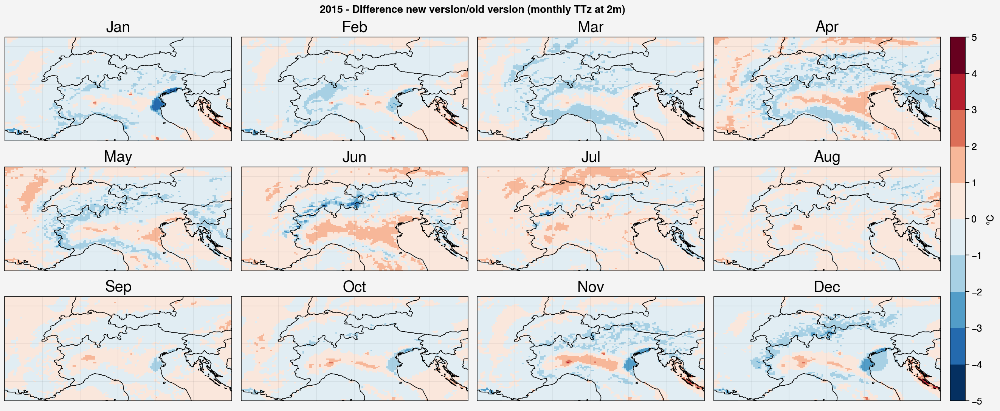

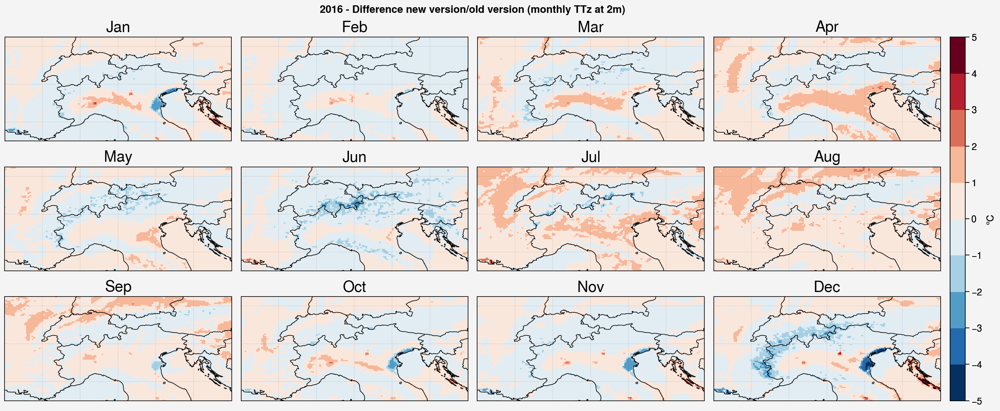

In [51]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diff_2015[mon],levels=np.linspace(-5,5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly TTz at 2m)")


f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diff_2016[mon],levels=np.linspace(-5,5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2016 - Difference new version/old version (monthly TTz at 2m)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

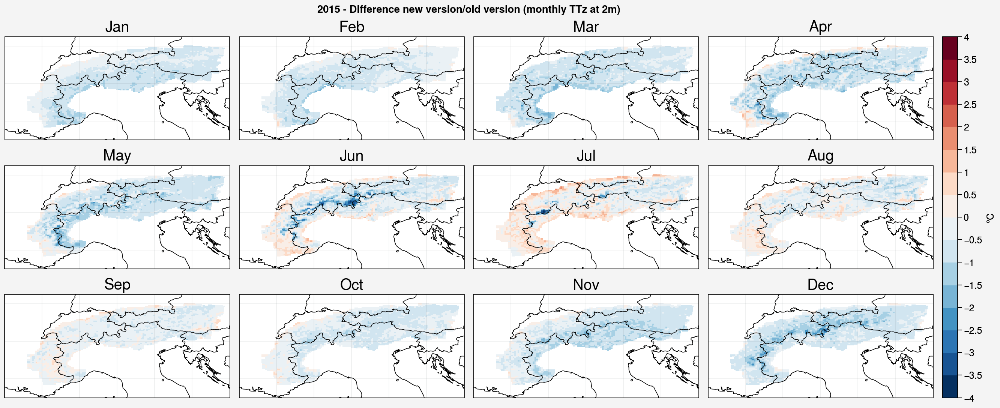

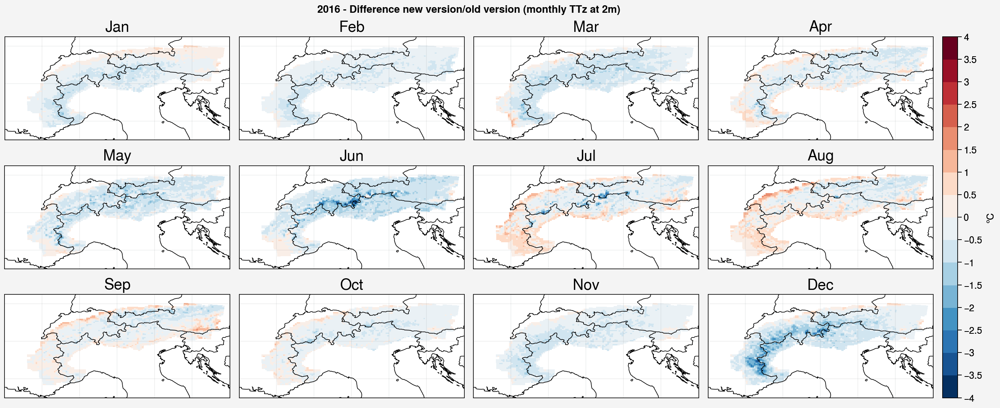

In [66]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    monthlyT_diff_2015_alps = np.ma.masked_array(monthlyT_diff_2015[mon],mask=np.invert(alps))
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diff_2015_alps,levels=np.linspace(-4,4,17),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly TTz at 2m)")


f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    monthlyT_diff_2016_alps = np.ma.masked_array(monthlyT_diff_2016[mon],mask=np.invert(alps))
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diff_2016_alps,levels=np.linspace(-4,4,17),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2016 - Difference new version/old version (monthly TTz at 2m)")



/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

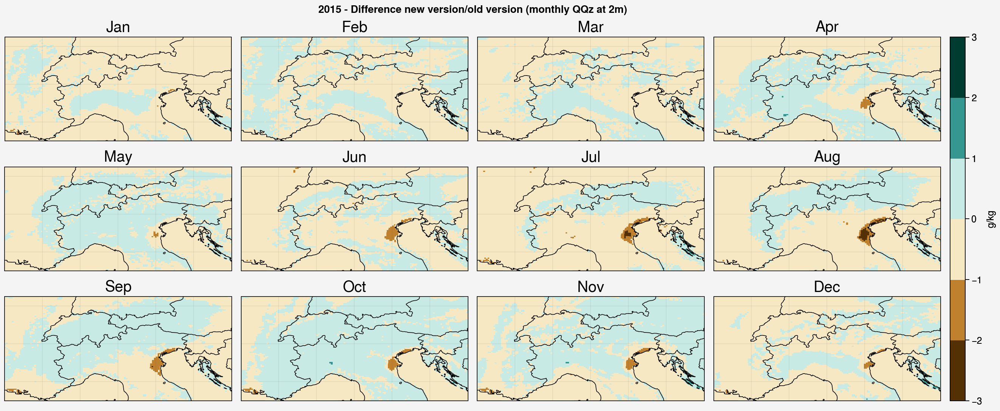

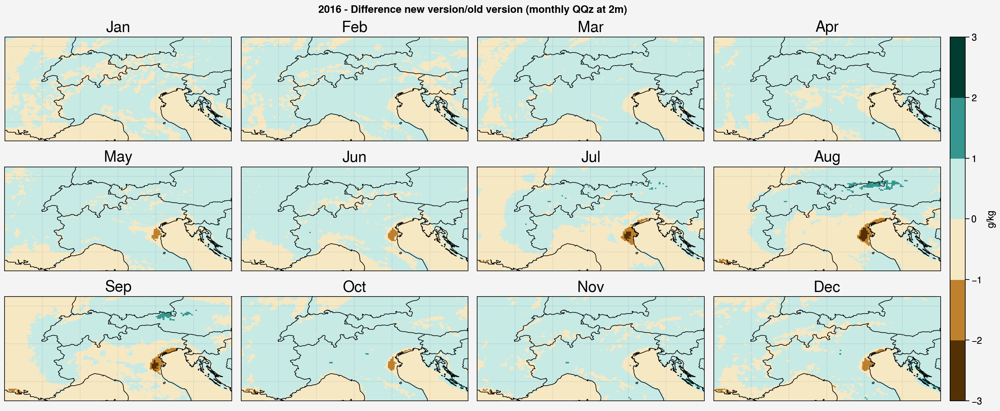

In [67]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyQQz_diff_2015[mon],levels=np.linspace(-3,3,7),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly QQz at 2m)")


f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyQQz_diff_2016[mon],levels=np.linspace(-3,3,7),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2016 - Difference new version/old version (monthly QQz at 2m)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

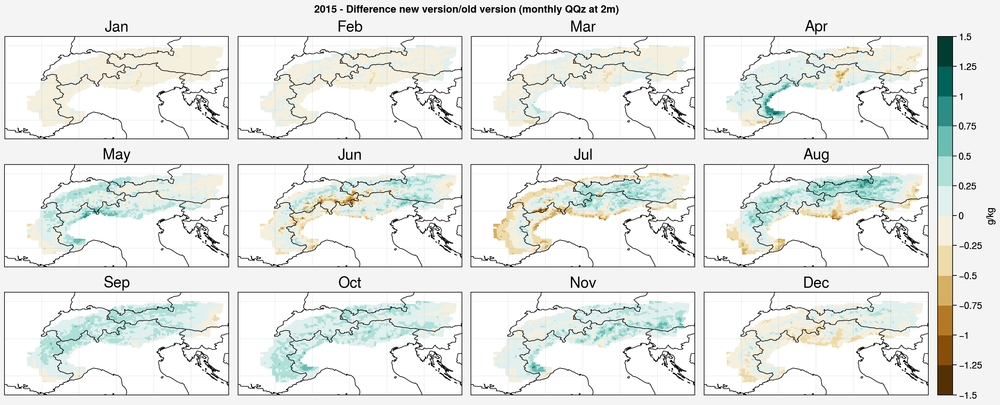

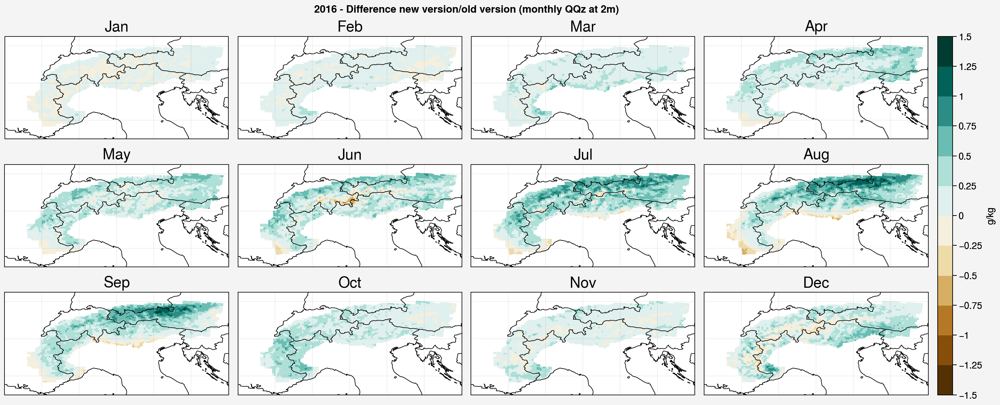

In [68]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    monthlyQQz_diff_2015_alps = np.ma.masked_array(monthlyQQz_diff_2015[mon],mask=np.invert(alps))
    m = axs[mon].pcolormesh(lon,lat,monthlyQQz_diff_2015_alps,levels=np.linspace(-1.5,1.5,13),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly QQz at 2m)")


f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    monthlyQQz_diff_2016_alps = np.ma.masked_array(monthlyQQz_diff_2016[mon],mask=np.invert(alps))
    m = axs[mon].pcolormesh(lon,lat,monthlyQQz_diff_2016_alps,levels=np.linspace(-1.5,1.5,13),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2016 - Difference new version/old version (monthly QQz at 2m)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

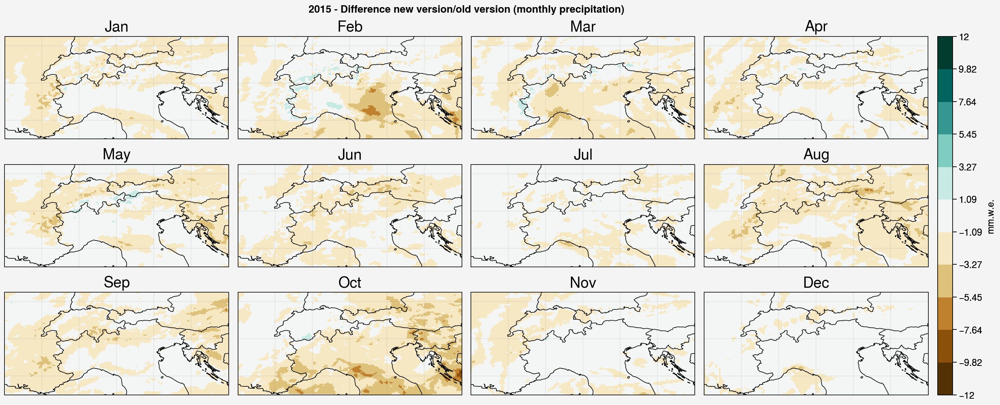

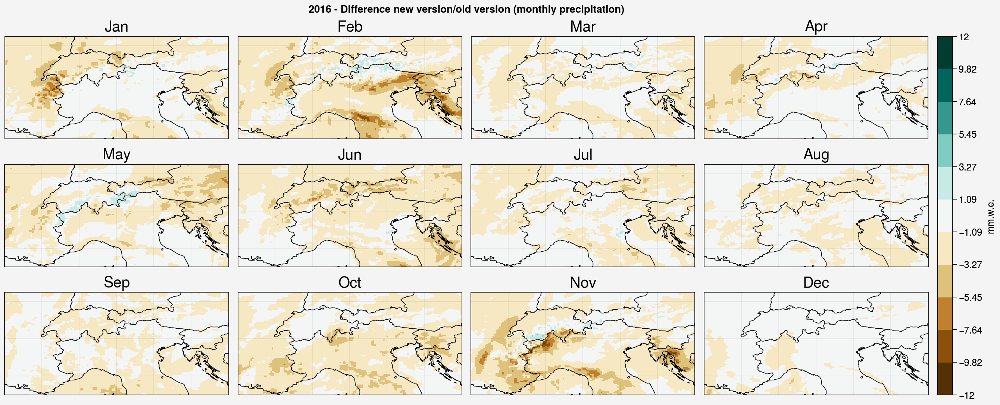

In [69]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyTP_diff_2015[mon],levels=np.linspace(-12,12,12),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm.w.e.')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly precipitation)")


f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyTP_diff_2016[mon],levels=np.linspace(-12,12,12),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm.w.e.')

axs.format(**multiplot_format,suptitle="2016 - Difference new version/old version (monthly precipitation)")

#### Humidity QQz

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

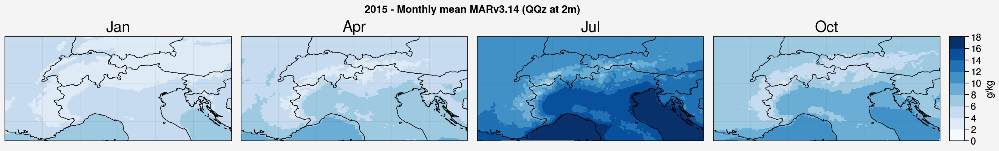

In [52]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4)

m = axs[0].pcolormesh(lon,lat,ds_QQz_v314_2015.groupby("time.month").mean("time")[0],levels=np.linspace(0,18,10),cmap='Blues')
axs[0].format(title='Jan',titlesize='20px')

m = axs[1].pcolormesh(lon,lat,ds_QQz_v314_2015.groupby("time.month").mean("time")[3],levels=np.linspace(0,18,10),cmap='Blues')
axs[1].format(title='Apr',titlesize='20px')

m = axs[2].pcolormesh(lon,lat,ds_QQz_v314_2015.groupby("time.month").mean("time")[6],levels=np.linspace(0,18,10),cmap='Blues')
axs[2].format(title='Jul',titlesize='20px')

m = axs[3].pcolormesh(lon,lat,ds_QQz_v314_2015.groupby("time.month").mean("time")[9],levels=np.linspace(0,18,10),cmap='Blues')
axs[3].format(title='Oct',titlesize='20px')
f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2015 - Monthly mean MARv3.14 (QQz at 2m)")

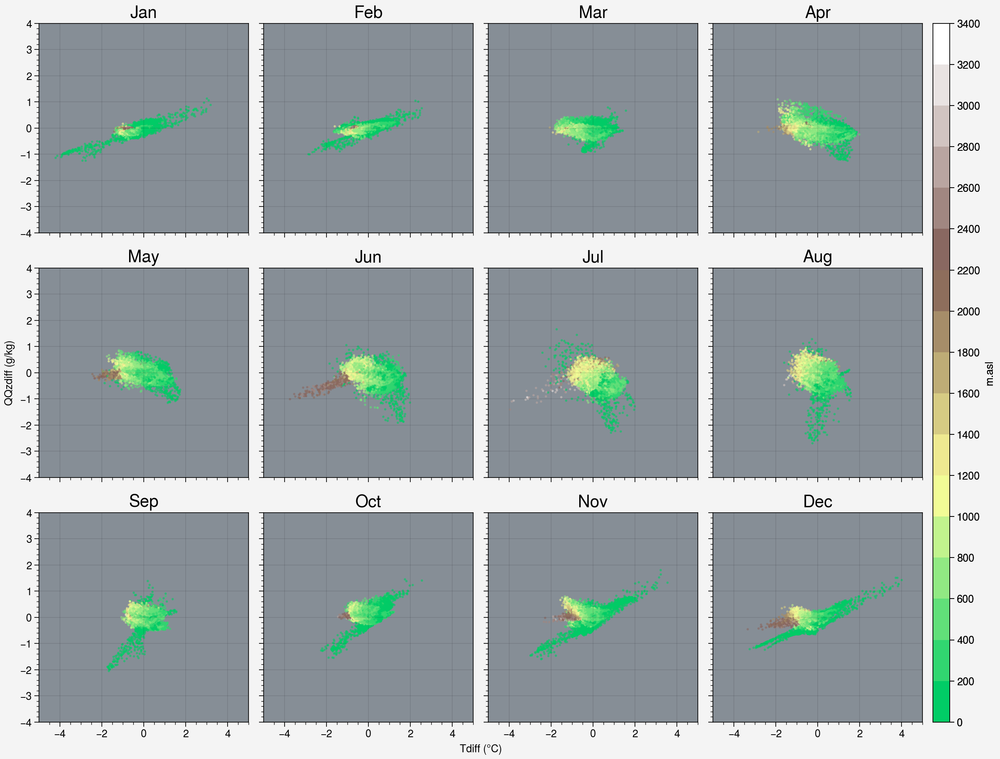

In [71]:
with pplt.rc.context({'axesfacecolor': 'gray6'}):
    f, axs = pplt.subplots(ncols=4,nrows=3)



for mon in range(12):
    ax = axs[mon]
    m = ax.scatter(monthlyT_diff_2015[mon].flatten(),monthlyQQz_diff_2015[mon].flatten(),s=2,alpha=0.5,c=H.flatten(),cmap=colors_land,levels=17) # *100 to put in percent
    ax.set_xlim((-5.,5))
    ax.set_ylim((-4.,4))
    ax.format(title=months[mon],titlesize='20px')

cbar = f.colorbar(m,label= 'm.asl')
cbar.solids.set(alpha=1)

axs.format(xlabel='Tdiff (°C)',ylabel='QQzdiff (g/kg)')

### Cartes de biais

In [72]:
# Monthly

monthlyT_diff = (monthlyT_diff_2015 + monthlyT_diff_2016)/2

print(monthlyT_diff_2015.max(),monthlyT_diff_2015.min())
print(monthlyT_diff_2016.max(),monthlyT_diff_2016.min())
print(monthlyT_diff.max(),monthlyT_diff.min())

4.0083065 -4.2015285
5.0356603 -5.2236395
4.511651 -4.217897


/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

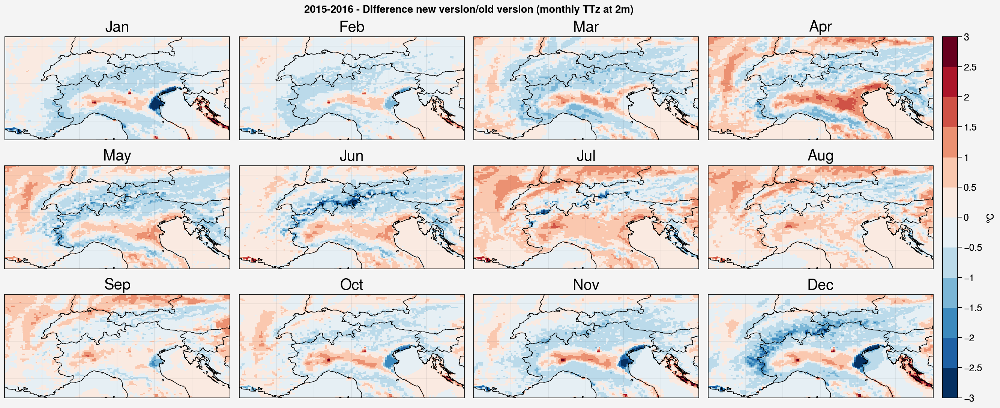

In [73]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diff[mon],levels=np.linspace(-3,3,13),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015-2016 - Difference new version/old version (monthly TTz at 2m)")

In [74]:
monthlyTP_diff = (monthlyTP_diff_2015 + monthlyTP_diff_2016)/2

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

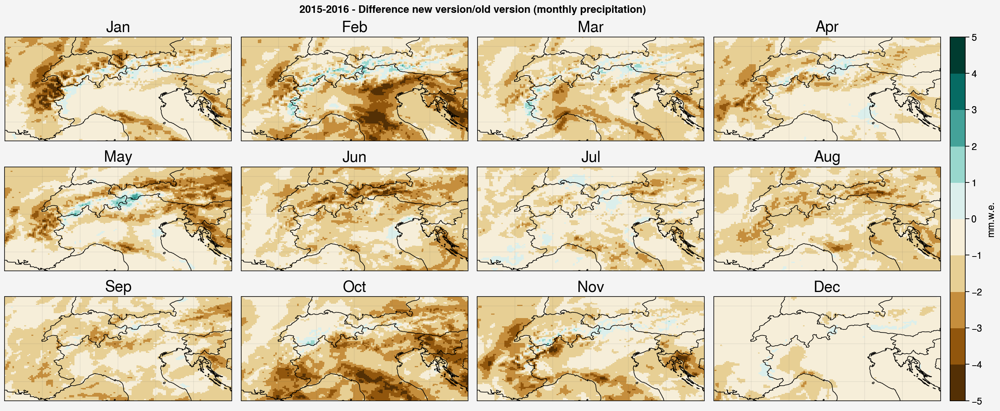

In [75]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyTP_diff[mon],levels=np.linspace(-5,5,11),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm.w.e.')

axs.format(**multiplot_format,suptitle="2015-2016 - Difference new version/old version (monthly precipitation)")

In [76]:
monthlyQQz_diff = (monthlyQQz_diff_2015 + monthlyQQz_diff_2016)/2

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

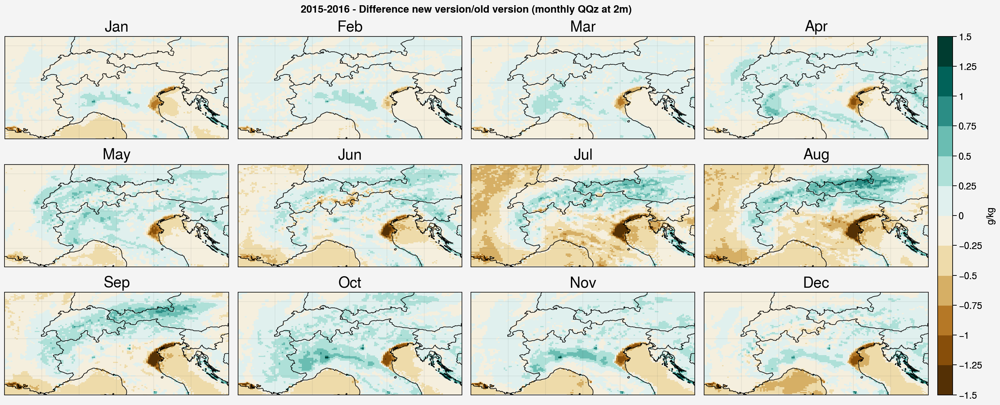

In [77]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyQQz_diff[mon],levels=np.linspace(-1.5,1.5,13),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2015-2016 - Difference new version/old version (monthly QQz at 2m)")

#### Nebulosity/Clouds

In [53]:
ds_CU_v314_2015 = xr.open_dataset(path_ian+'CU.2015.nc').CU[:,jmin:jmax,imin:imax]
ds_CU_v314_2016 = xr.open_dataset(path_ian+'CU.2016.nc').CU[:,jmin:jmax,imin:imax]
ds_CU_old_2015 = xr.open_dataset(path_ju+'CU.2015.nc').CU[:,jmin:jmax,imin:imax]
ds_CU_old_2016 = xr.open_dataset(path_ju+'CU.2016.nc').CU[:,jmin:jmax,imin:imax]

ds_CM_v314_2015 = xr.open_dataset(path_ian+'CM.2015.nc').CM[:,jmin:jmax,imin:imax]
ds_CM_v314_2016 = xr.open_dataset(path_ian+'CM.2016.nc').CM[:,jmin:jmax,imin:imax]
ds_CM_old_2015 = xr.open_dataset(path_ju+'CM.2015.nc').CM[:,jmin:jmax,imin:imax]
ds_CM_old_2016 = xr.open_dataset(path_ju+'CM.2016.nc').CM[:,jmin:jmax,imin:imax]

ds_CD_v314_2015 = xr.open_dataset(path_ian+'CD.2015.nc').CD[:,jmin:jmax,imin:imax]
ds_CD_v314_2016 = xr.open_dataset(path_ian+'CD.2016.nc').CD[:,jmin:jmax,imin:imax]
ds_CD_old_2015 = xr.open_dataset(path_ju+'CD.2015.nc').CD[:,jmin:jmax,imin:imax]
ds_CD_old_2016 = xr.open_dataset(path_ju+'CD.2016.nc').CD[:,jmin:jmax,imin:imax]

In [54]:
monthlyCU_diff_2015 = np.array(ds_CU_v314_2015.groupby("time.month").mean("time"))-np.array(ds_CU_old_2015.groupby("time.month").mean("time"))
monthlyCU_diff_2016 = np.array(ds_CU_v314_2016.groupby("time.month").mean("time")) - np.array(ds_CU_old_2016.groupby("time.month").mean("time"))
monthlyCU_diff = (monthlyCU_diff_2015 + monthlyCU_diff_2016)/2

monthlyCM_diff_2015 = np.array(ds_CM_v314_2015.groupby("time.month").mean("time"))-np.array(ds_CM_old_2015.groupby("time.month").mean("time"))
monthlyCM_diff_2016 = np.array(ds_CM_v314_2016.groupby("time.month").mean("time")) - np.array(ds_CM_old_2016.groupby("time.month").mean("time"))
monthlyCM_diff = (monthlyCM_diff_2015 + monthlyCM_diff_2016)/2

monthlyCD_diff_2015 = np.array(ds_CD_v314_2015.groupby("time.month").mean("time"))-np.array(ds_CD_old_2015.groupby("time.month").mean("time"))
monthlyCD_diff_2016 = np.array(ds_CD_v314_2016.groupby("time.month").mean("time")) - np.array(ds_CD_old_2016.groupby("time.month").mean("time"))
monthlyCD_diff = (monthlyCD_diff_2015 + monthlyCD_diff_2016)/2

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

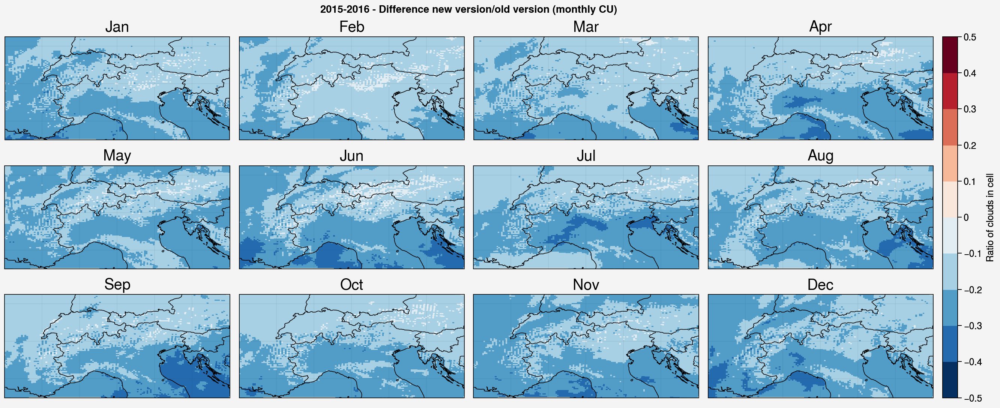

In [80]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyCU_diff[mon],levels=np.linspace(-0.5,0.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'Ratio of clouds in cell')

axs.format(**multiplot_format,suptitle="2015-2016 - Difference new version/old version (monthly CU)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

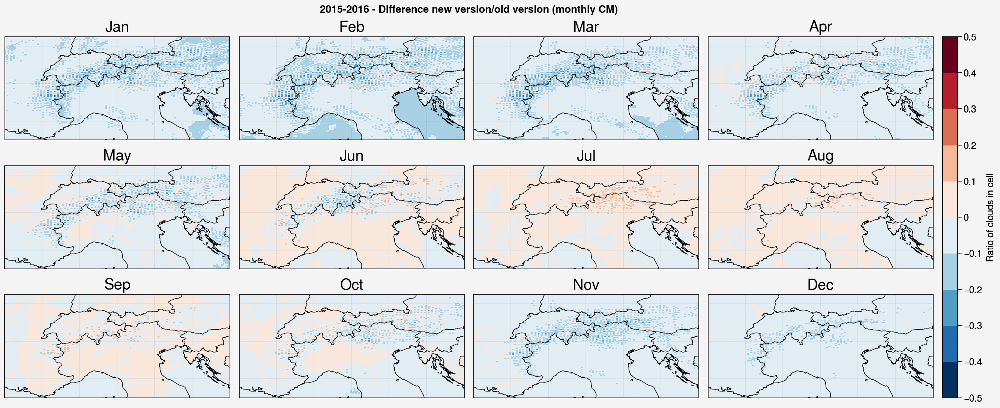

In [81]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyCM_diff[mon],levels=np.linspace(-0.5,0.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'Ratio of clouds in cell')

axs.format(**multiplot_format,suptitle="2015-2016 - Difference new version/old version (monthly CM)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

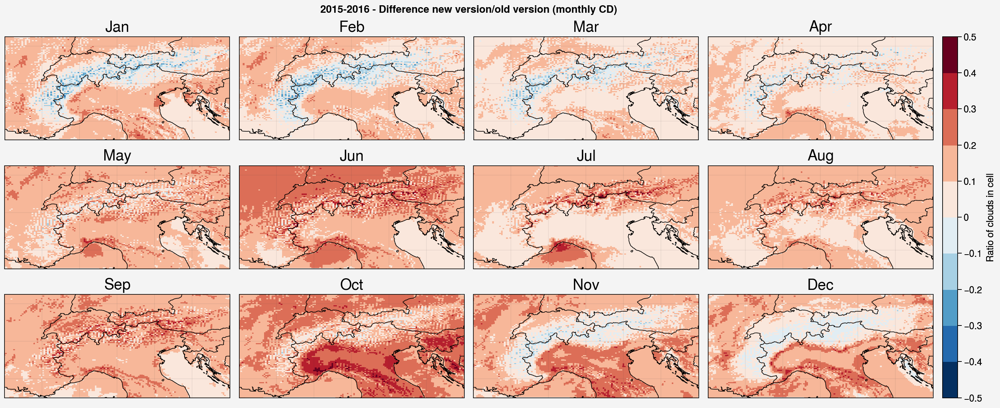

In [82]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyCD_diff[mon],levels=np.linspace(-0.5,0.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'Ratio of clouds in cell')

axs.format(**multiplot_format,suptitle="2015-2016 - Difference new version/old version (monthly CD)")

### EUc 2015

In [9]:
path_ju = '/bettik/beaumetj/MARout/MAR-ERA5/daily/ICE.ERA5_v1.EUl.'
#path_ian = '/bettik/castelli/data/MAR3.14/MAR-ERA5/EUb/ICE.ERA5.EUb.'
path_ian = '/bettik/castelli/data/MAR3.14/MAR-ERA5/EUc/ICE.ERA5.EUc.'

In [10]:
# Don't take 2014 as it is spin-up year

ds_T_v314_2015 = xr.open_dataset(path_ian+'TTz.2015.nc').TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_T_old_2015 = xr.open_dataset(path_ju+'TTz.2015.nc').TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]

Tdiff = list()
Tdiff.append(np.array(ds_T_v314_2015) - np.array(ds_T_old_2015))

ds_QQz_v314_2015 = xr.open_dataset(path_ian+'QQz.2015.nc').QQz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]
ds_QQz_old_2015 = xr.open_dataset(path_ju+'QQz.2015.nc').QQz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]

QQzdiff = list()
QQzdiff.append(np.array(ds_QQz_v314_2015) - np.array(ds_QQz_old_2015))

ds_RR_v314_2015 = xr.open_dataset(path_ian+'MBrr.2015.nc').MBrr[:,jmin:jmax,imin:imax]
ds_RR_old_2015 = xr.open_dataset(path_ju+'MBrr.2015.nc').MBrr[:,jmin:jmax,imin:imax]

ds_SF_v314_2015 = xr.open_dataset(path_ian+'MBsf.2015.nc').MBsf[:,jmin:jmax,imin:imax]
ds_SF_old_2015 = xr.open_dataset(path_ju+'MBsf.2015.nc').MBsf[:,jmin:jmax,imin:imax]

# TP : Total Precip

ds_TP_v314_2015 = ds_RR_v314_2015 + ds_SF_v314_2015
ds_TP_old_2015 = ds_RR_old_2015 + ds_SF_old_2015

TPdiff = list()
TPdiff.append(np.array(ds_TP_v314_2015) - np.array(ds_TP_old_2015))

In [11]:
# Monthly

monthlyT_diff_2015 = np.array(ds_T_v314_2015.groupby("time.month").mean("time"))-np.array(ds_T_old_2015.groupby("time.month").mean("time"))

print(monthlyT_diff_2015.max(),monthlyT_diff_2015.min())

4.025052 -5.0034084


In [12]:
monthlyQQz_diff_2015 = np.array(ds_QQz_v314_2015.groupby("time.month").mean("time"))-np.array(ds_QQz_old_2015.groupby("time.month").mean("time"))

print(monthlyQQz_diff_2015.max(),monthlyQQz_diff_2015.min())

1.9480424 -1.8962278


In [13]:
monthlyTP_diff_2015 = np.array(ds_TP_v314_2015.groupby("time.month").mean("time")) - np.array(ds_TP_old_2015.groupby("time.month").mean("time"))

print(monthlyTP_diff_2015.max(),monthlyTP_diff_2015.min())

3.7767866 -6.349509


/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

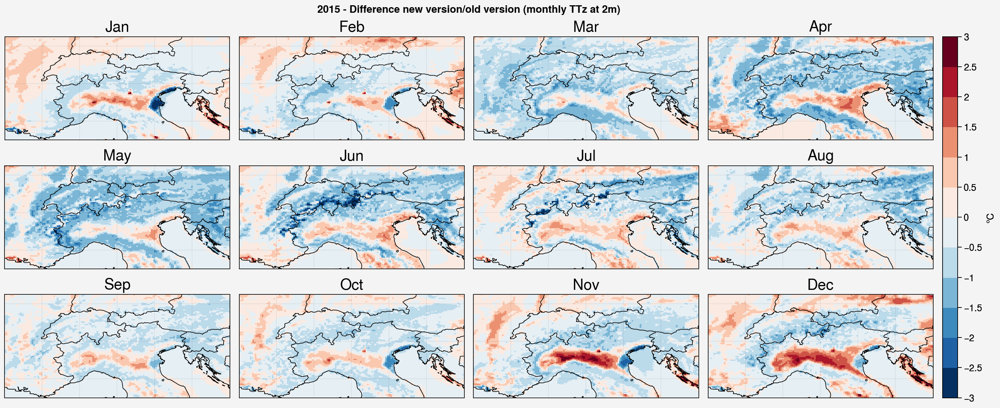

In [13]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diff_2015[mon],levels=np.linspace(-3,3,13),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly TTz at 2m)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

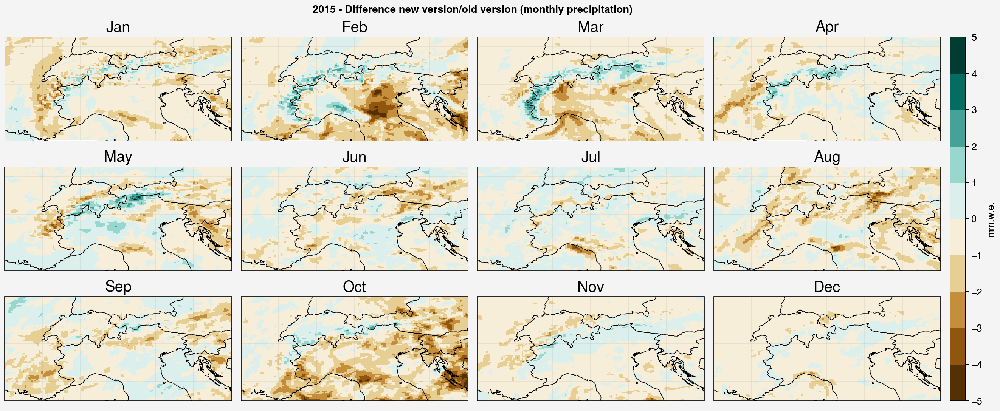

In [28]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyTP_diff_2015[mon],levels=np.linspace(-5,5,11),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm.w.e.')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly precipitation)")

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

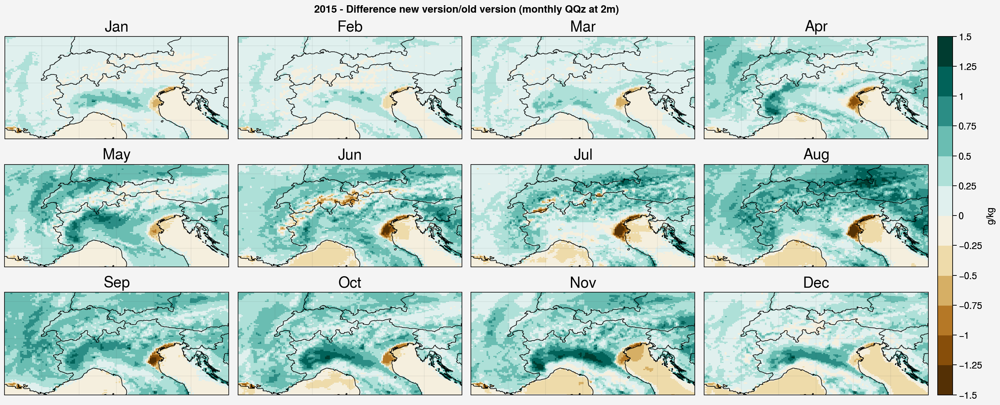

In [29]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sep','Oct','Nov','Dec']

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyQQz_diff_2015[mon],levels=np.linspace(-1.5,1.5,13),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'g/kg')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/old version (monthly QQz at 2m)")

### Obs

In [14]:
ds_TG_EOBS = xr.open_dataset('/bettik/castelli/data/E-OBS/tg_ens_mean_0.1deg_reg_v29.0e.nc').tg.isel(latitude=np.arange(170,250,1),longitude=np.arange(280,430,1))
ds_RR_EOBS = xr.open_dataset('/bettik/castelli/data/E-OBS/rr_ens_mean_0.1deg_reg_v29.0e.nc').rr.isel(latitude=np.arange(170,250,1),longitude=np.arange(280,430,1))
ds_HU_EOBS = xr.open_dataset('/bettik/castelli/data/E-OBS/hu_ens_mean_0.1deg_reg_v29.0e.nc').hu.isel(latitude=np.arange(170,250,1),longitude=np.arange(280,430,1))

ds_TG_EOBS

<xarray.DataArray 'tg' (time: 27028, latitude: 80, longitude: 150)>
[324336000 values with dtype=float32]
Coordinates:
  * latitude   (latitude) float64 42.05 42.15 42.25 42.35 ... 49.75 49.85 49.95
  * longitude  (longitude) float64 3.05 3.15 3.25 3.35 ... 17.75 17.85 17.95
  * time       (time) datetime64[ns] 1950-01-01 1950-01-02 ... 2023-12-31
Attributes:
    units:          Celsius
    long_name:      mean temperature
    standard_name:  air_temperature
    cell_methods:   time: mean

In [15]:
ds_TG_EOBS_2015 = ds_TG_EOBS.sel(time='2015')
ds_TG_EOBS_2016 = ds_TG_EOBS.sel(time='2016')

ds_RR_EOBS_2015 = ds_RR_EOBS.sel(time='2015')
ds_HU_EOBS_2015 = ds_HU_EOBS.sel(time='2015')

ds_TG_EOBS_2015

<xarray.DataArray 'tg' (time: 365, latitude: 80, longitude: 150)>
[4380000 values with dtype=float32]
Coordinates:
  * latitude   (latitude) float64 42.05 42.15 42.25 42.35 ... 49.75 49.85 49.95
  * longitude  (longitude) float64 3.05 3.15 3.25 3.35 ... 17.75 17.85 17.95
  * time       (time) datetime64[ns] 2015-01-01 2015-01-02 ... 2015-12-31
Attributes:
    units:          Celsius
    long_name:      mean temperature
    standard_name:  air_temperature
    cell_methods:   time: mean

In [16]:
ds_TG_EOBS = 0
ds_RR_EOBS = 0
ds_HU_EOBS = 0

In [17]:
lon_EOBS = np.array(ds_TG_EOBS_2015.longitude)
lat_EOBS = np.array(ds_TG_EOBS_2015.latitude)

monthlyTG_EOBS_2015 = np.array(ds_TG_EOBS_2015.groupby("time.month").mean("time"))
monthlyTG_EOBS_2016 = np.array(ds_TG_EOBS_2016.groupby("time.month").mean("time"))
monthlyTG_EOBS = (monthlyTG_EOBS_2015 + monthlyTG_EOBS_2016)/2

/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/miniforge3/envs/phd_v1/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to ins

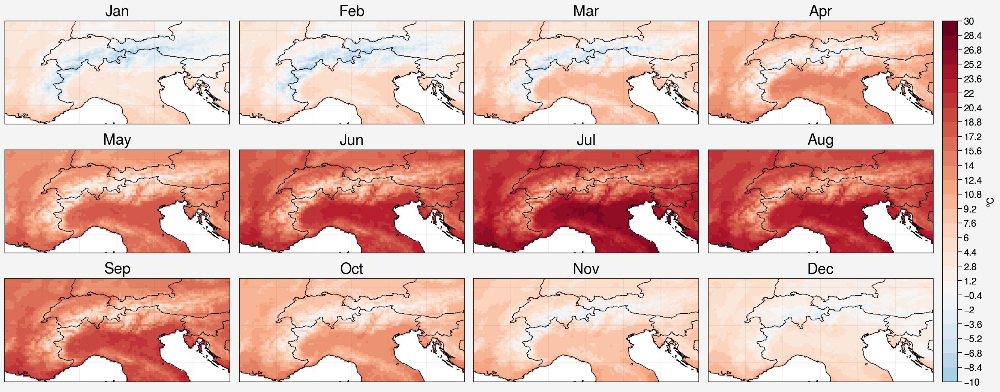

In [21]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,monthlyTG_EOBS[mon],levels=np.linspace(-10,30,26),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="")

#### Comparing to Obs

In [18]:
lon_correct_xy = ds.LON[jmin:jmax,imin:imax] # copy the lon/lat with incorrect x/y (small differences with the x/y of the MAR simulation)
lat_correct_xy = ds.LAT[jmin:jmax,imin:imax]

lon_correct_xy["x"] = ("x", ds_T_v314_2015.x.values) # correct the incorrect x/y
lon_correct_xy["y"] = ("y", ds_T_v314_2015.y.values)

lat_correct_xy["x"] = ("x", ds_T_v314_2015.x.values)
lat_correct_xy["y"] = ("y", ds_T_v314_2015.y.values)


ds_T_v314_2015.coords['lon'] = lon_correct_xy
ds_T_v314_2015.coords['lat'] = lat_correct_xy

ds_T_old_2015.coords['lon'] = ds.LON[jmin:jmax,imin:imax]
ds_T_old_2015.coords['lat'] = ds.LAT[jmin:jmax,imin:imax]

ds_T_v314_2015

<xarray.DataArray 'TTz' (time: 365, y: 91, x: 139)>
array([[[ 9.214099,  9.306477, ...,  8.027635,  7.924051],
        [ 9.037285,  9.118703, ...,  7.991868,  7.832749],
        ...,
        [-0.032535,  0.339872, ..., -2.329796, -2.629418],
        [-0.238095,  0.266634, ..., -2.168661, -2.447447]],

       [[11.961897, 12.11707 , ..., 12.562517, 12.596089],
        [11.863504, 12.069141, ..., 12.577668, 12.601375],
        ...,
        [ 2.23749 ,  2.470863, ...,  3.166391,  2.520758],
        [ 2.303823,  2.548503, ...,  3.327955,  2.823113]],

       ...,

       [[13.655927, 13.676003, ..., 12.068644, 11.933764],
        [13.629679, 13.656385, ..., 11.997559, 11.87512 ],
        ...,
        [ 6.46274 ,  6.623821, ...,  0.514162,  0.542313],
        [ 6.14258 ,  6.303067, ...,  0.448407,  0.484608]],

       [[13.863091, 13.913135, ...,  9.326861,  9.285624],
        [13.884362, 13.934706, ...,  9.291603,  9.253032],
        ...,
        [ 8.326447,  8.285563, ..., -3.827857, -3.787593],
        [ 8.095393,  8.20113 , ..., -3.95102 , -3.839536]]], dtype=float32)
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T12:00:00 ... 2015-12-31T12:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
    ztqlev   float32 2.0
    lon      (y, x) float32 ...
    lat      (y, x) float32 ...
Attributes:
    units:          C
    long_name:      Temperature
    standard_name:  Temperature
    actual_range:   [-20.691431  20.232143]
    cell_methods:   time: mean

In [19]:
ds_T_v314_2015_regrid = u.regrid(ds_T_v314_2015,ds_TG_EOBS_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False) # globe=True gives an error, because of scipy.sparse.csr_matrix(X)
                                                                                    # in add_matrix_NaNs

ds_T_old_2015_regrid = u.regrid(ds_T_old_2015,ds_TG_EOBS_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False) # globe=True gives an error, because of scipy.sparse.csr_matrix(X)
                                                                                    # in add_matrix_NaNs

In [23]:
ds_TG_EOBS_2015_regrid = u.regrid(ds_TG_EOBS_2015,ds_T_v314_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False) # globe=True gives an error, because of scipy.sparse.csr_matrix(X)
                                                                                    # in add_matrix_NaNs

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

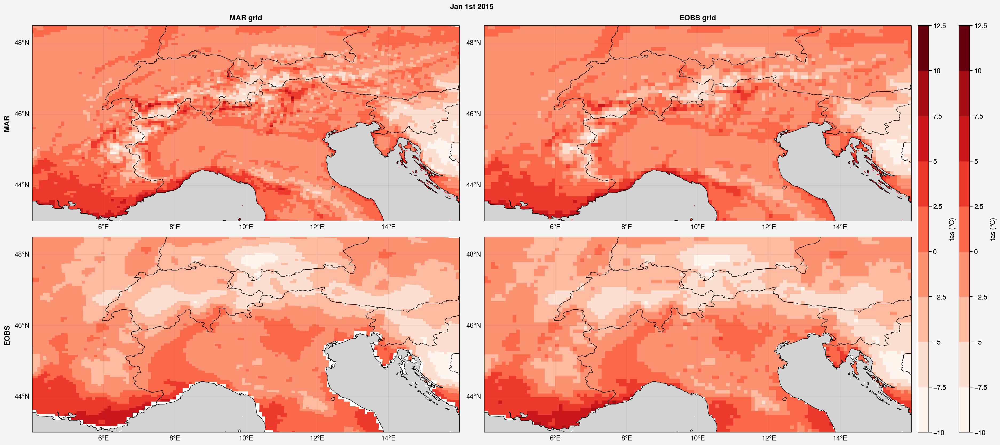

In [67]:
f, axs = pplt.subplots(proj='cyl', axwidth=8,ncols=2,nrows=2)

#MAR
m=axs[0].pcolormesh(lon, lat, ds_T_v314_2015[0], levels=np.linspace(-10,12.5,10),cmap='Reds')

m=axs[1].pcolormesh(lon_EOBS, lat_EOBS, ds_T_v314_2015_regrid[0], levels=np.linspace(-10,12.5,10),cmap='Reds')
f.colorbar(m,label= 'tas (°C)')

#EOBS
m=axs[2].pcolormesh(lon, lat, ds_TG_EOBS_2015_regrid[0], levels=np.linspace(-10,12.5,10),cmap='Reds')

m=axs[3].pcolormesh(lon_EOBS, lat_EOBS, ds_TG_EOBS_2015[0], levels=np.linspace(-10,12.5,10),cmap='Reds')
f.colorbar(m,label= 'tas (°C)')

axs.format(**normal_format)
axs.format(ocean=True,oceancolor='lightgray',reso='hi',suptitle='Jan 1st 2015',collabels=['MAR grid','EOBS grid'],rowlabels=['MAR','EOBS'])

In [24]:
ds_T_v314_2015_monthly = ds_T_v314_2015.groupby("time.month").mean("time")
ds_T_v314_2015_regrid_monthly = ds_T_v314_2015_regrid.groupby("time.month").mean("time")

ds_T_old_2015_monthly = ds_T_old_2015.groupby("time.month").mean("time")
ds_T_old_2015_regrid_monthly = ds_T_old_2015_regrid.groupby("time.month").mean("time")

ds_TG_EOBS_2015_regrid_monthly = ds_TG_EOBS_2015_regrid.groupby("time.month").mean("time")

monthlyT_diffEOBS_2015 = ds_T_v314_2015_monthly.values - ds_TG_EOBS_2015_regrid_monthly
monthlyT_diffEOBS_2015_2 = ds_T_v314_2015_regrid_monthly.values - monthlyTG_EOBS_2015
monthlyT_diff_old_EOBS_2015 = ds_T_old_2015_regrid_monthly.values - monthlyTG_EOBS_2015

In [25]:
monthlyT_diffEOBS_2015.shape

(12, 91, 139)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

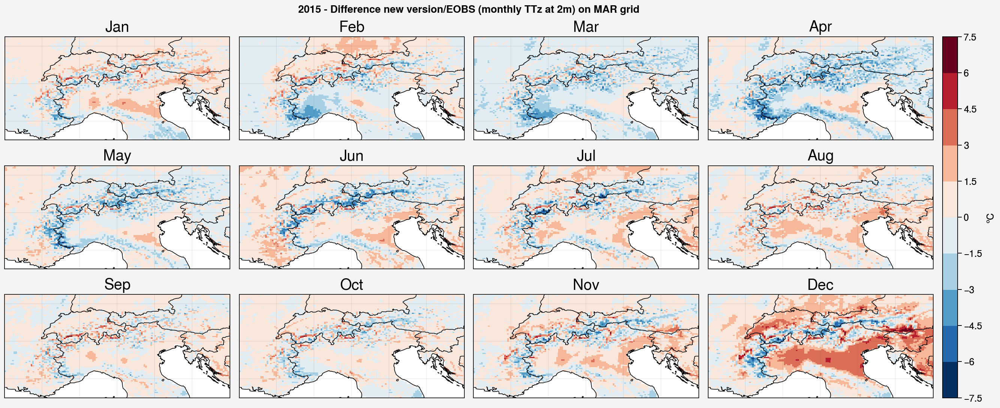

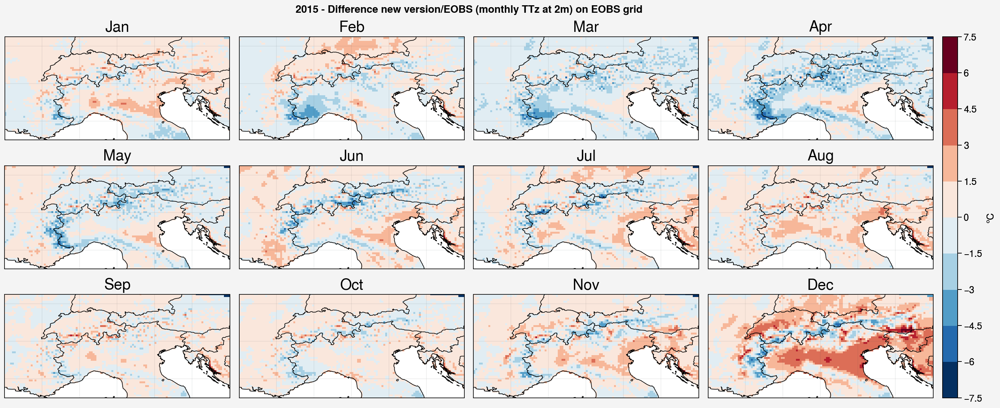

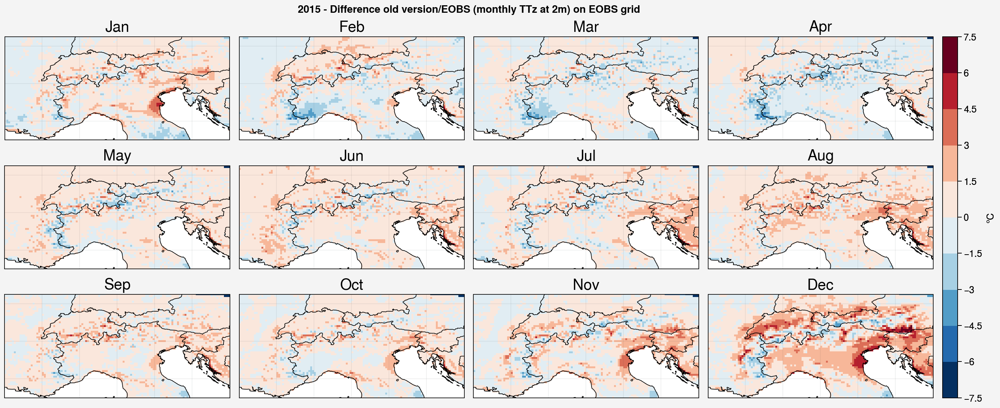

In [75]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,monthlyT_diffEOBS_2015[mon],levels=np.linspace(-7.5,7.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/EOBS (monthly TTz at 2m) on MAR grid")

# -------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,monthlyT_diffEOBS_2015_2[mon],levels=np.linspace(-7.5,7.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/EOBS (monthly TTz at 2m) on EOBS grid")

#--------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,monthlyT_diff_old_EOBS_2015[mon],levels=np.linspace(-7.5,7.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference old version/EOBS (monthly TTz at 2m) on EOBS grid")


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


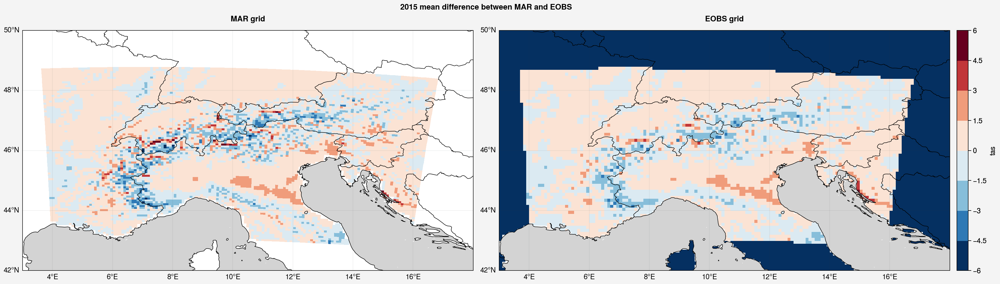

In [76]:
yearlyT_diffEOBS_2015 = ds_T_v314_2015.mean("time").values - ds_TG_EOBS_2015_regrid.mean("time").values

yearlyT_diffEOBS_2015_2 = ds_T_v314_2015_regrid.mean("time").values - ds_TG_EOBS_2015.mean("time").values

f, axs = pplt.subplots(proj='cyl', axwidth=8,ncols=2)

m=axs[0].pcolormesh(lon, lat, yearlyT_diffEOBS_2015, levels=np.linspace(-6,6,9),cmap='RdBu_r')

m=axs[1].pcolormesh(lon_EOBS, lat_EOBS, yearlyT_diffEOBS_2015_2, levels=np.linspace(-6,6,9),cmap='RdBu_r')
f.colorbar(m,label= 'tas')

#axs.format(**normal_format)
axs.format(**big_format)
axs.format(ocean=True,oceancolor='lightgray',reso='hi',suptitle='2015 mean difference between MAR and EOBS',collabels=['MAR grid','EOBS grid'])

In [26]:
ds_TP_v314_2015.coords['lon'] = lon_correct_xy
ds_TP_v314_2015.coords['lat'] = lat_correct_xy

ds_TP_old_2015.coords['lon'] = ds.LON[jmin:jmax,imin:imax]
ds_TP_old_2015.coords['lat'] = ds.LAT[jmin:jmax,imin:imax]

ds_TP_v314_2015_regrid = u.regrid(ds_TP_v314_2015,ds_RR_EOBS_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False) # globe=True gives an error, because of scipy.sparse.csr_matrix(X)
                                                                                    # in add_matrix_NaNs
ds_TP_old_2015_regrid = u.regrid(ds_TP_old_2015,ds_RR_EOBS_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False)

ds_TP_v314_2015_regrid_monthly = ds_TP_v314_2015_regrid.groupby("time.month").mean("time")
ds_TP_old_2015_regrid_monthly = ds_TP_old_2015_regrid.groupby("time.month").mean("time")
ds_RR_EOBS_2015_monthly = ds_RR_EOBS_2015.groupby("time.month").mean("time")

monthlyTP_diffEOBS_2015 = ds_TP_v314_2015_regrid_monthly.values - ds_RR_EOBS_2015_monthly
monthlyTP_diff_old_EOBS_2015 = ds_TP_old_2015_regrid_monthly.values - ds_RR_EOBS_2015_monthly

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

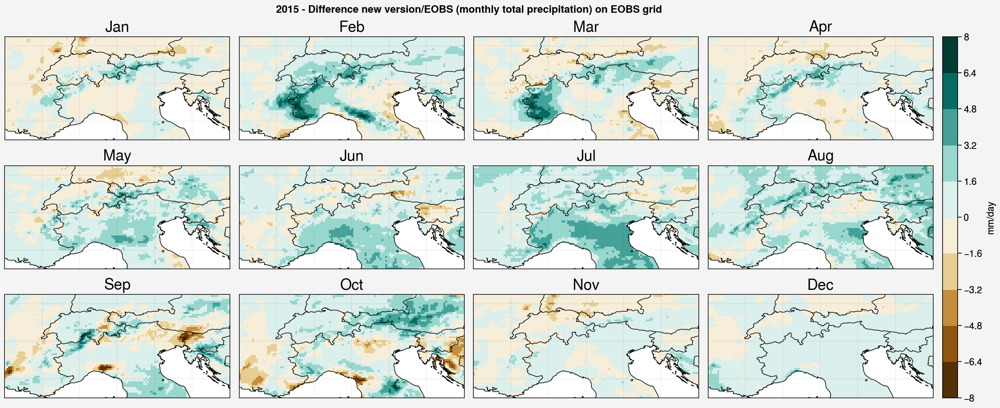

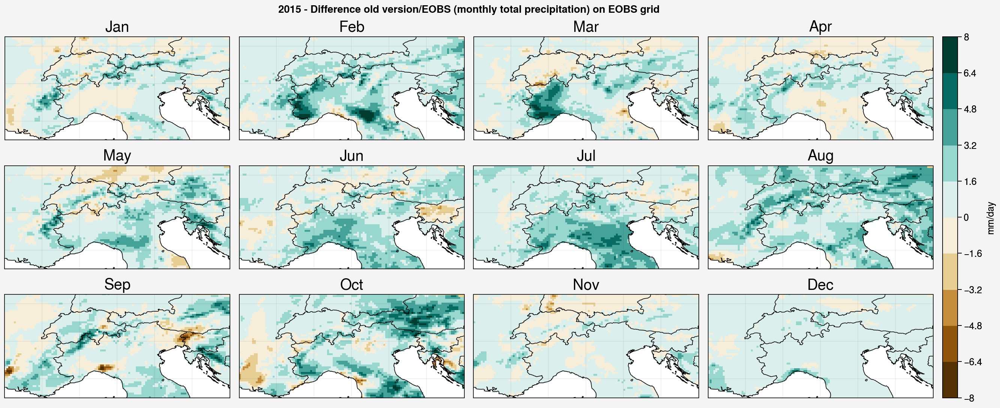

In [78]:
# -------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,monthlyTP_diffEOBS_2015[mon],levels=np.linspace(-8,8,11),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm/day')

axs.format(**multiplot_format,suptitle="2015 - Difference new version/EOBS (monthly total precipitation) on EOBS grid")

# -------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,monthlyTP_diff_old_EOBS_2015[mon],levels=np.linspace(-8,8,11),cmap='BrBG')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm/day')

axs.format(**multiplot_format,suptitle="2015 - Difference old version/EOBS (monthly total precipitation) on EOBS grid")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

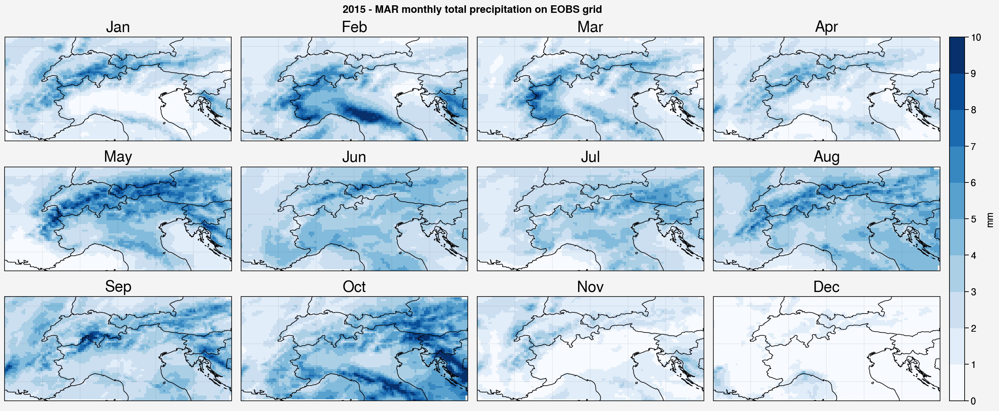

In [49]:
# -------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,ds_TP_v314_2015_regrid_monthly.values[mon],cmap='Blues',vmin=0,vmax=10)
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm/day')

axs.format(**multiplot_format,suptitle="2015 - MAR monthly total precipitation on EOBS grid")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

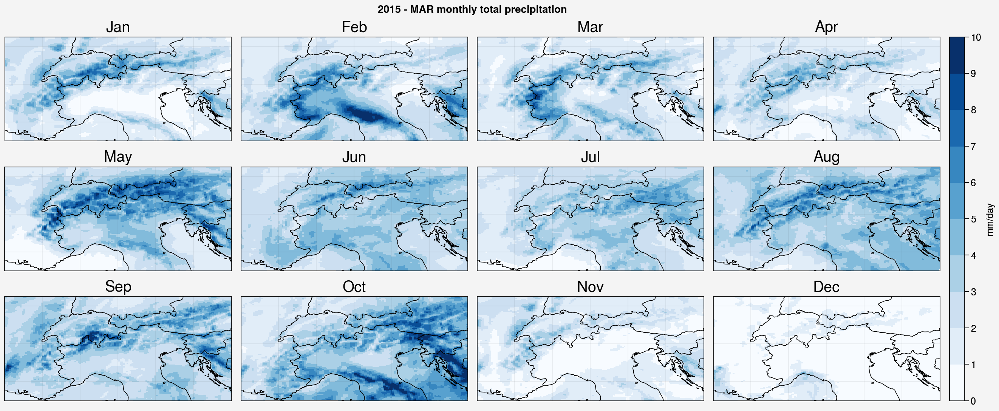

In [52]:
# -------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon,lat,ds_TP_test_v314_2015.groupby("time.month").mean("time").values[mon],cmap='Blues',vmin=0,vmax=10)
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm/day')

axs.format(**multiplot_format,suptitle="2015 - MAR monthly total precipitation")



In [27]:
monthly_RR_EOBS = daily_to_monthly(ds_RR_EOBS_2015.values,leap_year=False)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

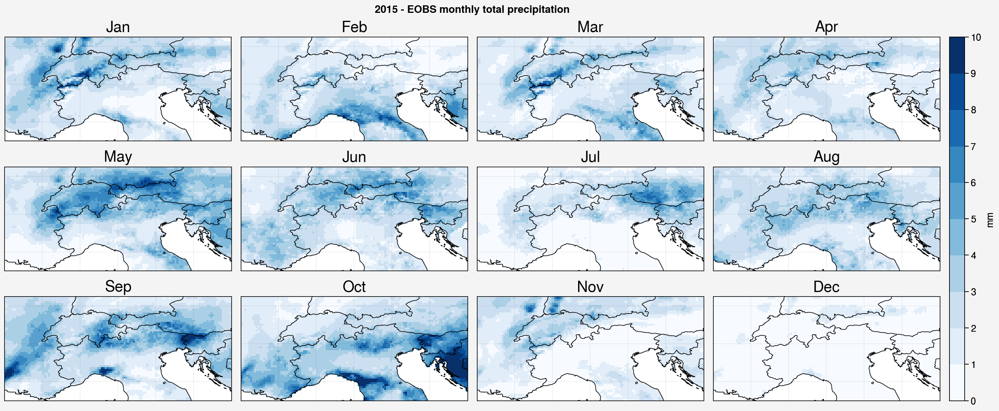

In [55]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,monthly_RR_EOBS[mon],cmap='Blues',vmin=0,vmax=10)
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= 'mm')

axs.format(**multiplot_format,suptitle="2015 - EOBS monthly total precipitation")

### Comparing ERA5 with EOBS

In [28]:
#ds_ERA5 = xr.open_dataset('/bettik/castelli/MARin/input/ERA5/2015/ECM.2015.01.01-05.EUR.nc')
ds_t2m_ERA5 = xr.open_dataset('/bettik/castelli/data/ERA5/t2m.2015.asme5.GLOBAL_025.nc')

ds_t2m_ERA5

<xarray.Dataset>
Dimensions:    (longitude: 1440, latitude: 721, time: 12)
Coordinates:
  * longitude  (longitude) float32 0.0 0.25 0.5 0.75 ... 359.0 359.2 359.5 359.8
  * latitude   (latitude) float32 90.0 89.75 89.5 89.25 ... -89.5 -89.75 -90.0
  * time       (time) datetime64[ns] 2015-01-01 2015-02-01 ... 2015-12-01
Data variables:
    t2m        (time, latitude, longitude) float32 ...
Attributes:
    Conventions:                 CF-1.6
    NCO:                         netCDF Operators version 4.9.7 (Homepage = h...
    title:                       ERA5 reanalysis
    data_type:                   1xmonthly fields analysis
    grid_resolution_in_degrees:  0.25
    source:                      credit: ECMWF, COPERNICUS Climate Change Ser...
    history:                     Tue Jun 21 14:53:42 2022: ncatted -a history...

In [29]:
ds_t2m_ERA5_2015 = ds_t2m_ERA5.t2m.isel(latitude=np.arange(160,190,1),longitude=np.arange(15,75,1)) - 273.15
ds_t2m_ERA5_2015.shape

(12, 30, 60)

In [30]:
lon_ERA5 = np.array(ds_t2m_ERA5_2015.longitude)
lat_ERA5 = np.array(ds_t2m_ERA5_2015.latitude)

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


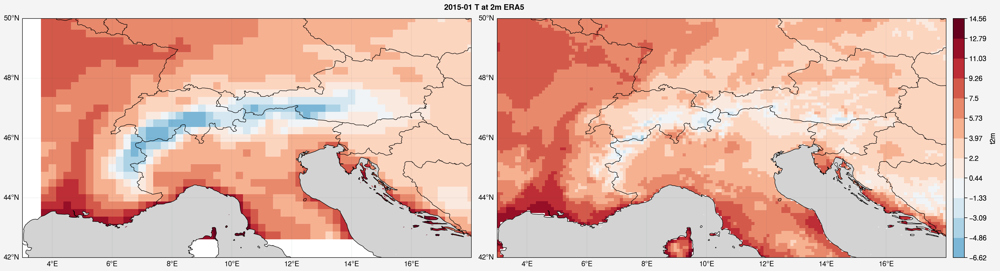

In [28]:
f, axs = pplt.subplots(proj='cyl', axwidth=8,ncols = 2)

map1 = ds_t2m_ERA5_2015[-1]
map2 = monthlyTG_EOBS_2015[-1]

min_colorbar = np.min([np.nanmin(map1),np.nanmin(map2)])
max_colorbar = np.max([np.nanmax(map1),np.nanmax(map2)])

m=axs[0].pcolormesh(lon_ERA5, lat_ERA5, ds_t2m_ERA5_2015[-1], levels=np.linspace(min_colorbar,max_colorbar,13),cmap='RdBu_r')

m=axs[1].pcolormesh(lon_EOBS, lat_EOBS, monthlyTG_EOBS_2015[-1], levels=np.linspace(min_colorbar,max_colorbar,13),cmap='RdBu_r')
f.colorbar(m,label= 't2m')

#axs.format(**normal_format)
axs.format(**big_format)
axs.format(ocean=True,oceancolor='lightgray',reso='hi',suptitle='2015-01 T at 2m ERA5')

In [31]:
ds_TG_EOBS_2015_regridERA5 = u.regrid(ds_TG_EOBS_2015,ds_t2m_ERA5_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False) # globe=True gives an error, because of scipy.sparse.csr_matrix(X)
                                                                                    # in add_matrix_NaNs
ds_TG_EOBS_2015_regridERA5_monthly = ds_TG_EOBS_2015_regridERA5.groupby("time.month").mean("time")


ds_t2m_ERA5_2015_regridEOBS = u.regrid(ds_t2m_ERA5_2015,ds_TG_EOBS_2015,'bilinear',
                                      globe=True,periodic=False,reuse_weights=False)


/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "
/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAx

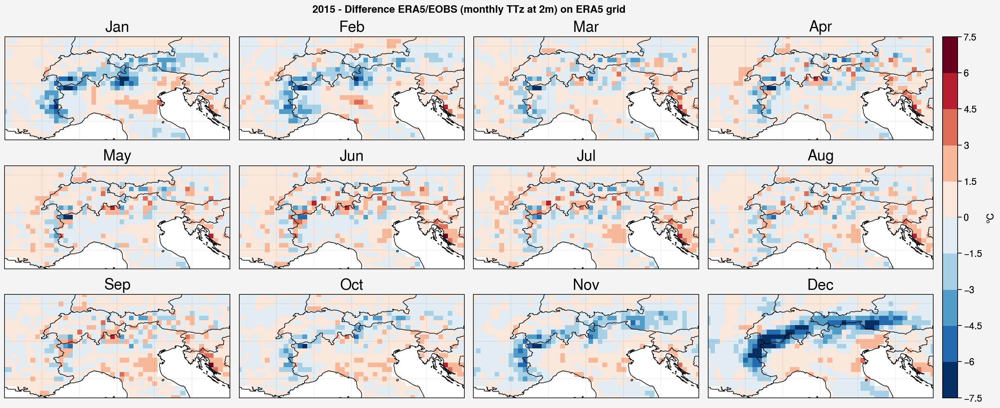

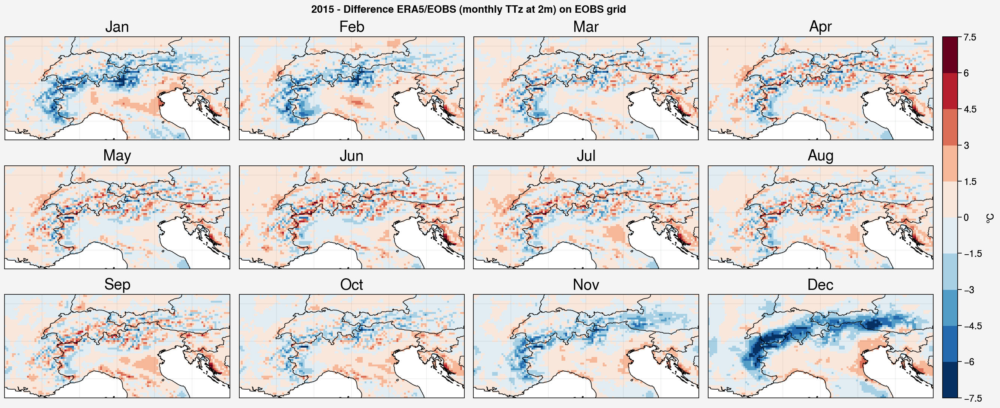

In [33]:
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_ERA5,lat_ERA5,ds_t2m_ERA5_2015[mon] - ds_TG_EOBS_2015_regridERA5_monthly[mon],levels=np.linspace(-7.5,7.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference ERA5/EOBS (monthly TTz at 2m) on ERA5 grid")

# -----------------------------------------------------------------------------------------------------
f, axs = pplt.subplots(proj='cyl',axwidth=3,ncols=4,nrows=3)

for mon in range(12):
    m = axs[mon].pcolormesh(lon_EOBS,lat_EOBS,ds_t2m_ERA5_2015_regridEOBS[mon] - monthlyTG_EOBS_2015[mon],levels=np.linspace(-7.5,7.5,11),cmap='RdBu_r')
    axs[mon].format(title=months[mon],titlesize='20px')

f.colorbar(m, label= '°C')

axs.format(**multiplot_format,suptitle="2015 - Difference ERA5/EOBS (monthly TTz at 2m) on EOBS grid")

In [35]:
toto = ds_t2m_ERA5_2015 - ds_TG_EOBS_2015_regridERA5_monthly

toto.min()

<xarray.DataArray ()>
array(-28.735752, dtype=float32)

In [32]:
np.linspace(-7.5,7.5,11)

array([-7.5, -6. , -4.5, -3. , -1.5,  0. ,  1.5,  3. ,  4.5,  6. ,  7.5])

### EUd

In [10]:
ds_314_new = xr.open_dataset('/bettik/castelli/MARout/EUd/d03/2015/ICE.d03.2015.01.01-31.nc').GF[:,jmin:jmax,imin:imax]#.TTz.isel(ztqlev=0)[:,jmin:jmax,imin:imax]

ds_314_new

<xarray.DataArray 'GF' (time: 31, y: 91, x: 139)>
[392119 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2015-01-01T12:00:00 ... 2015-01-31T12:00:00
  * x        (x) float32 -259.0 -252.0 -245.0 -238.0 ... 686.0 693.0 700.0 707.0
  * y        (y) float32 -168.0 -161.0 -154.0 -147.0 ... 441.0 448.0 455.0 462.0
Attributes:
    units:          W/m2
    long_name:      Ground Flux
    standard_name:  Ground_Flux
    actual_range:   [-2.4407077  3.5539873]

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


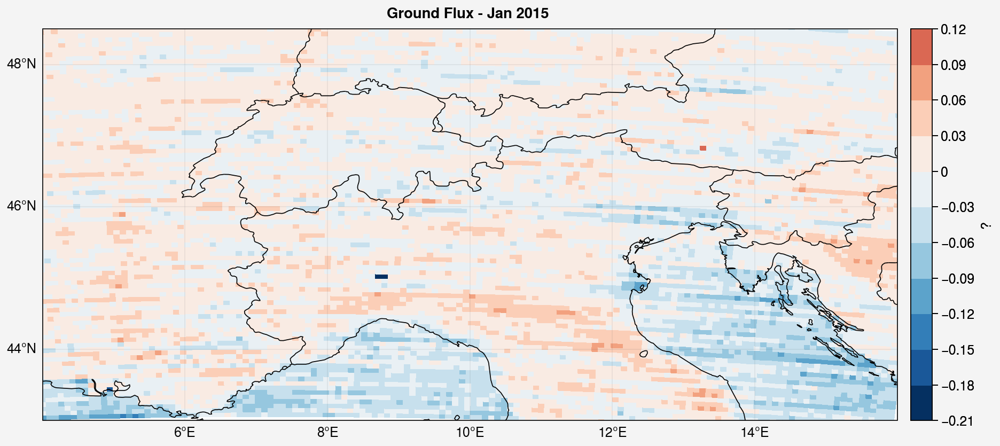

In [13]:
f, axs = pplt.subplots(proj='cyl',axwidth=8)

m = axs.pcolormesh(lon,lat,ds_314_new.mean(axis=0))#,levels=np.linspace(-10,10,11),cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= '?')

axs.format(**normal_format,suptitle="Ground Flux - Jan 2015 ")

/home/castelli/.conda/envs/phd_v3/lib/python3.10/site-packages/cartopy/mpl/geoaxes.py:403: UserWarning: The `map_projection` keyword argument is deprecated, use `projection` to instantiate a GeoAxes instead.
  warnings.warn("The `map_projection` keyword argument is "


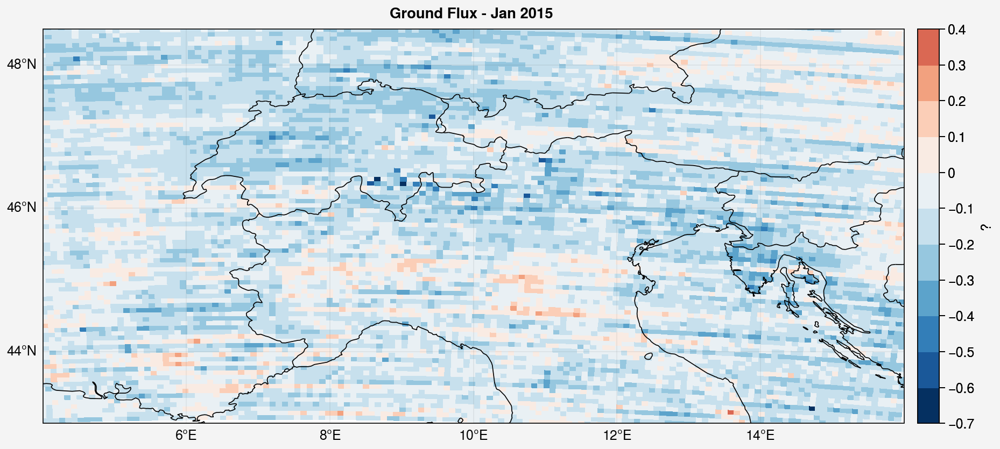

In [17]:
f, axs = pplt.subplots(proj='cyl',axwidth=8)

m = axs.pcolormesh(lon,lat,ds_314_new[3])#,levels=np.linspace(-10,10,11),cmap='RdBu_r')
axs.format(titlesize='20px')

f.colorbar(m, label= '?')

axs.format(**normal_format,suptitle="Ground Flux - Jan 2015 ")